In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import *
from helper_functions import *
from models import *
import plotly.express as px
import os
import pickle

In [4]:
folder_path = 'RT_datasets'
df_list = []  # Initialize an empty list to store the DataFrames
y_pred_h_list = []
y_pred_b_list = []
y_test_h_list = []
y_test_b_list = []
X_test_h_list = []
X_test_list = []
type_dict = {'A': 0,
             'H': 1,
             'C': 2,
             'A, C': 3,
             'P': 4,
             'D': 5,
             'MOD': 6,
             'PH': 7}

gooon = True
dict_jic_lengths = {}

for i, filename in enumerate(os.listdir(folder_path)):
    file_path = os.path.join(folder_path, filename)
    if filename != '.DS_Store':
        dfRT = pd.read_csv(file_path)
    #if filename.split('-')[0] == 'AMPGV':
    #if filename == 'AMPGV-200-4001.csv':
    if dfRT.shape[0] > 9 and 'nrtask' in dfRT.columns:
        df_list.append(dfRT)  # Append the DataFrame to the list
        features = ['scheduled_labor_hours', 'actual_labor_hours', 'type', 'flycycle', 'flyhour', 'jic_code']
        targets = ['nrtask', 'nrlabour', 'nr_boolean']
        df_encoded = prepare_data_lgbm(dfRT, features, targets)
        df_encoded['jic_code'] = i
        df_encoded = df_encoded.replace(type_dict)
        dict_jic_lengths[df_encoded['jic_code'][0]] = dfRT.shape[0]
        df_encoded.loc[df_encoded['nrlabour'] == 0, 'nr_boolean'] = 0
        y_pred_h, y_pred, y_test_h, y_test_b, X_test_h, X_test = full_LGBM(df_encoded)
        y_pred_h_list.append(pd.Series(y_pred_h))
        y_pred_b_list.append(pd.Series(y_pred))
        y_test_h_list.append(pd.Series(y_test_h))
        y_test_b_list.append(pd.Series(y_test_b))
        X_test_h_list.append(X_test_h)
        X_test_list.append(X_test)

# Concatenate all DataFrames in the list to create df_tot
df_tot = pd.concat(df_list, ignore_index=True)
y_pred_h = pd.concat(y_pred_h_list, ignore_index=True)
y_pred = pd.concat(y_pred_b_list, ignore_index=True)
y_test_b = pd.concat(y_test_b_list, ignore_index=True)
y_test_h = pd.concat(y_test_h_list, ignore_index=True)
X_test_h = pd.concat(X_test_h_list, ignore_index=True)
X_test = pd.concat(X_test_list, ignore_index=True)



/Users/mickhekkema/Desktop/MSc Aerospace Engineering/Q4/SAT Project/SAT Project - code/helper_functions.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sorted[col] = df_sorted[col].fillna('Missing')
/Users/mickhekkema/Desktop/MSc Aerospace Engineering/Q4/SAT Project/SAT Project - code/helper_functions.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sorted[col] = df_sorted[col].astype('category')
/Users/mickhekkema/Desktop/MSc Aerospace Engineering/Q4/SAT Project/SAT Project - code/helper_fun

In [5]:
X_test

,flycycle,jic_code,type,nrlabour-1,nrlabour-2,nrtask-4,nrlabour-5,nrtask-1,flyhour,nrlabour-4,nrlabour-3,nrtask-2,nrtask-5,scheduled_labor_hours,actual_labor_hours,nrtask-3
0,9219.0,1,0,0.0,0.0,0.0,0.0,0.0,80037.0,0.0,0.0,0.0,0.0,2.0,0.10000,0.0
1,9326.0,1,0,0.0,0.0,0.0,0.0,0.0,76528.0,0.0,0.0,0.0,0.0,2.0,2.00000,0.0
2,8877.0,1,0,0.0,0.0,0.0,0.0,0.0,75605.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.0
3,9219.0,1,0,0.0,0.0,0.0,0.0,0.0,80037.0,0.0,0.0,0.0,0.0,2.0,2.00000,0.0
4,9905.0,1,0,0.0,0.0,0.0,0.0,0.0,85214.0,0.0,0.0,0.0,0.0,2.0,2.00000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139946,10747.0,10201,0,0.0,0.0,0.0,0.0,0.0,92430.0,0.0,0.0,0.0,0.0,0.0,0.03334,0.0
139947,7700.0,10201,0,0.0,0.0,0.0,0.0,0.0,66111.0,0.0,0.0,0.0,0.0,0.0,2.50000,0.0
139948,10381.0,10201,0,0.0,0.0,0.0,0.0,0.0,88667.0,0.0,0.0,0.0,0.0,0.0,0.50000,0.0
139949,8158.0,10201,0,0.0,0.0,0.0,0.0,0.0,69992.0,0.0,0.0,0.0,0.0,0.0,0.50000,0.0


              precision    recall  f1-score   support

           0       0.94      0.97      0.96    126041
           1       0.62      0.45      0.53     13910

    accuracy                           0.92    139951
   macro avg       0.78      0.71      0.74    139951
weighted avg       0.91      0.92      0.91    139951



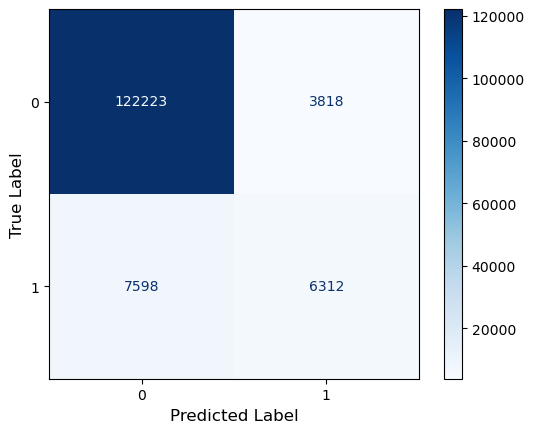

In [6]:
# Generate the classification report
report = classification_report(y_test_b, y_pred, target_names=[str(label) for label in sorted(y_test_b.unique())])
# Print the classification report
print(report)

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test_b, y_pred)
# Get the unique labels from the test set (this should match the classes in y_test_n['nrtask'])
unique_labels = sorted(y_test_b.unique())

# Display the confusion matrix with axis labels
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=unique_labels)
disp.plot(cmap=plt.cm.Blues)  # You can change the color map if desired

# Add axis labels
plt.xlabel('Predicted Label', fontsize=12)
plt.ylabel('True Label', fontsize=12)
plt.show()

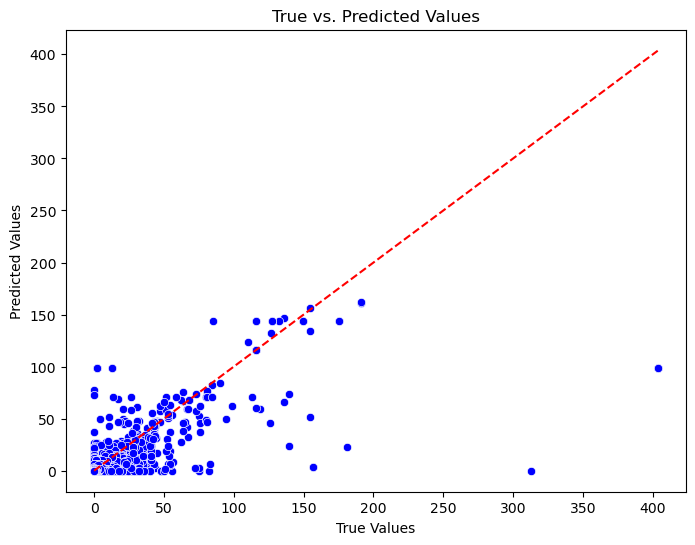

MAE = 0.262
MAE of 0 = 0.341
MAE of mean = 0.619


In [7]:
# Plotting
plt.figure(figsize=(8, 6))  # Set the figure size for better visibility
sns.scatterplot(x=y_test_h, y=y_pred_h, color='blue')  # Scatter plot of y_true vs y_pred

# Line of perfect prediction
plt.plot([y_test_h.min(), y_test_h.max()], [y_test_h.min(), y_test_h.max()], 'r--')  # Red dashed line

# Adding plot labels and title
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.title('True vs. Predicted Values')

# Show the plot
plt.show()

mae = mean_absolute_error(y_test_h, y_pred_h)
mae_0 = mean_absolute_error(y_test_h, np.zeros(shape=y_test_h.shape))
mae_mean = mean_absolute_error(y_test_h, np.mean(y_test_h)*np.ones(shape=y_test_h.shape))
print(f'MAE = {round(mae, 3)}')
print(f'MAE of 0 = {round(mae_0, 3)}')
print(f'MAE of mean = {round(mae_mean, 3)}')

In [8]:
df = pd.DataFrame({
    'True Values': y_test_h,
    'Predicted Values': y_pred_h
})

# Create a scatter plot
fig = px.scatter(df, x='True Values', y='Predicted Values', title='True vs. Predicted Values',
                 labels={'x': 'True Values', 'y': 'Predicted Values'}, color_discrete_sequence=['blue'])

# Add line of perfect prediction
fig.add_shape(
    type='line', line=dict(dash='dash', color='red'),
    x0=y_test_h.min(), y0=y_test_h.min(), x1=y_test_h.max(), y1=y_test_h.max()
)

# Show the plot
fig.show()

In [9]:
# Function to load an object from a pickle file
def load_from_pickle(file_name, load_directory):
    file_path = os.path.join(load_directory, file_name)
    with open(file_path, 'rb') as file:
        return pickle.load(file)

In [ ]:
# y_pred_h_full = pd.Series(y_pred_h_full)


In [10]:
# Add the total samples count for each jic_code to X_test_h
X_test_h['total_samples'] = X_test_h['jic_code'].map(dict_jic_lengths)
X_test_h['abs_deviation'] = abs(y_pred_h - y_test_h)
X_test_h['zero_deviation'] = abs(y_test_h)
X_test_h['prediction'] = y_pred_h
X_test_h['accuracy'] = (y_pred == y_test_b).astype(int)
X_test_h['zeros'] =  (1-y_test_b)
X_test_h['ones'] =  y_test_b
# Ensure that predictions and actual results are evaluated element-wise
X_test_h['pp'] = ((y_pred == 1) & (y_test_b == 1)).astype(int)
X_test_h['fp'] = ((y_pred == 1) & (y_test_b == 0)).astype(int)
X_test_h['fn'] = ((y_pred == 0) & (y_test_b == 1)).astype(int)
X_test_h['pn'] = ((y_pred == 0) & (y_test_b == 0)).astype(int)


/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_53126/461757122.py:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



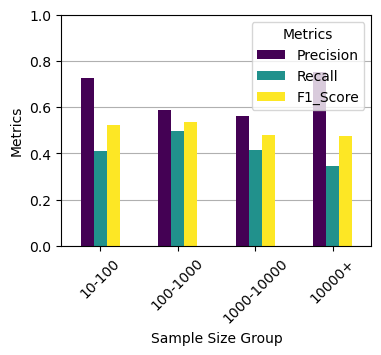

In [25]:
# Create bins for total samples
bins = [10, 100, 1000, 10000, np.inf]
labels = ['10-100', '100-1000', '1000-10000', '10000+']
X_test_h['sample_bin'] = pd.cut(X_test_h['total_samples'], bins=bins, labels=labels, right=False)

# Aggregate sums of TP, FP, FN, and TN for each bin
binned_grouped = X_test_h.groupby('sample_bin').agg(
    MAD=('abs_deviation', 'mean'),
    MZD=('zero_deviation', 'mean'),
    MP=('prediction', 'mean'),
    MA=('accuracy', 'mean'),
    MZ=('zeros', 'mean'),
    MO=('ones', 'mean'),
    TP=('pp', 'sum'),
    FP=('fp', 'sum'),
    FN=('fn', 'sum'),
    TN=('pn', 'sum')
)

# Calculate Precision, Recall, and F1 Score using the aggregated sums
binned_grouped['Precision'] = binned_grouped['TP'] / (binned_grouped['TP'] + binned_grouped['FP'])
binned_grouped['Recall'] = binned_grouped['TP'] / (binned_grouped['TP'] + binned_grouped['FN'])
binned_grouped['F1_Score'] = 2 * (binned_grouped['Precision'] * binned_grouped['Recall']) / (binned_grouped['Precision'] + binned_grouped['Recall'])

# Replace NaN results with zero (to handle cases where TP+FP or TP+FN are zero, which means Precision or Recall cannot be calculated)
binned_grouped[['Precision', 'Recall', 'F1_Score']] = binned_grouped[['Precision', 'Recall', 'F1_Score']].fillna(0)

fig, ax = plt.subplots(figsize=(4, 3))  # Specify the figsize here directly
binned_grouped[['Precision', 'Recall', 'F1_Score']].plot(kind='bar', colormap='viridis', ax=ax, zorder=2)
#ax.set_title('Precision, Recall, and F1 Score by Sample Size Group')
ax.set_xlabel('Sample Size Group')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # Rotate labels to 45 degrees
ax.set_ylabel('Metrics')
ax.set_ylim([0, 1])
ax.grid(True, axis='y')
ax.legend(title='Metrics')
plt.show()

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_53126/1285972858.py:29: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



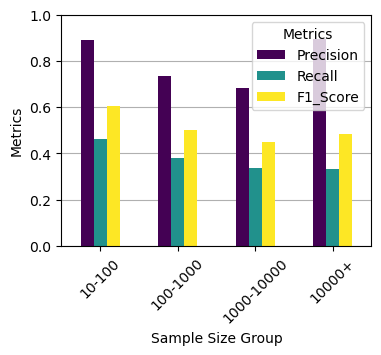

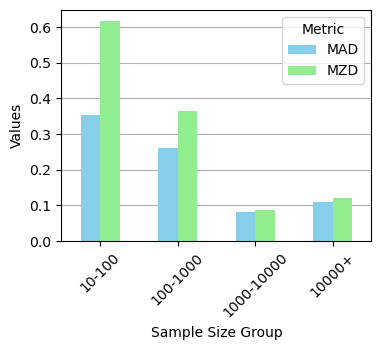

MAE = 0.231
MAE of 0 = 0.341
MAE of mean = 0.619


In [27]:
binary_model = load_from_pickle('LGBM_binary.pkl', 'Models')
regress_model = load_from_pickle('LGBM_regress.pkl', 'Models')
y_test_h_full = load_from_pickle('y_test_h.pkl', 'Sets')
y_test_b_full = load_from_pickle('y_test_b.pkl', 'Sets')
X_test_full = load_from_pickle('X_test.pkl', 'Sets')
dict_jic_lengths_full = load_from_pickle('dict_jic_lengths.pkl', 'Sets')

y_pred_full = binary_model.predict(X_test_full)
y_pred_full = pd.Series(y_pred_full, name='nr_boolean')
y_pred_h_full = regress_model.predict(X_test_full)
y_pred_h_full[y_pred_full == 0] = 0
y_pred_h_full[y_pred_h_full < 0] = 0

# Add the total samples count for each jic_code to X_test_h
X_test_full['total_samples'] = X_test_full['jic_code'].map(dict_jic_lengths_full)
X_test_full['abs_deviation'] = abs(y_pred_h_full - y_test_h_full)
X_test_full['zero_deviation'] = abs(y_test_h_full)
X_test_full['prediction'] = y_pred_h_full
X_test_full['accuracy'] = (y_pred_full == y_test_b_full).astype(int)
X_test_full['zeros'] =  (1-y_test_b_full)
X_test_full['ones'] =  y_test_b_full
# Ensure that predictions and actual results are evaluated element-wise
X_test_full['pp'] = ((y_pred_full == 1) & (y_test_b_full == 1)).astype(int)
X_test_full['fp'] = ((y_pred_full == 1) & (y_test_b_full == 0)).astype(int)
X_test_full['fn'] = ((y_pred_full == 0) & (y_test_b_full == 1)).astype(int)
X_test_full['pn'] = ((y_pred_full == 0) & (y_test_b_full == 0)).astype(int)
X_test_full['sample_bin'] = pd.cut(X_test_full['total_samples'], bins=bins, labels=labels, right=False)

binned_grouped_full = X_test_full.groupby('sample_bin').agg(
    MAD=('abs_deviation', 'mean'),
    MZD=('zero_deviation', 'mean'),
    MP=('prediction', 'mean'),
    MA=('accuracy', 'mean'),
    MZ=('zeros', 'mean'),
    MO=('ones', 'mean'),
    TP=('pp', 'sum'),
    FP=('fp', 'sum'),
    FN=('fn', 'sum'),
    TN=('pn', 'sum')
)

# Calculate Precision, Recall, and F1 Score using the aggregated sums
binned_grouped_full['Precision'] = binned_grouped_full['TP'] / (binned_grouped_full['TP'] + binned_grouped_full['FP'])
binned_grouped_full['Recall'] = binned_grouped_full['TP'] / (binned_grouped_full['TP'] + binned_grouped_full['FN'])
binned_grouped_full['F1_Score'] = 2 * (binned_grouped_full['Precision'] * binned_grouped_full['Recall']) / (binned_grouped_full['Precision'] + binned_grouped_full['Recall'])

# Replace NaN results with zero (to handle cases where TP+FP or TP+FN are zero, which means Precision or Recall cannot be calculated)
binned_grouped_full[['Precision', 'Recall', 'F1_Score']] = binned_grouped_full[['Precision', 'Recall', 'F1_Score']].fillna(0)

fig, ax = plt.subplots(figsize=(4, 3))  # Specify the figsize here directly
binned_grouped_full[['Precision', 'Recall', 'F1_Score']].plot(kind='bar', colormap='viridis', ax=ax, zorder=2)
#ax.set_title('Precision, Recall, and F1 Score by Sample Size Group')
ax.set_xlabel('Sample Size Group')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # Rotate labels to 45 degrees
ax.set_ylabel('Metrics')
ax.set_ylim([0, 1])
ax.grid(True, axis='y')
ax.legend(title='Metrics')
plt.show()

# Creating a plot with specified figure size
fig, ax = plt.subplots(figsize=(4, 3))
binned_grouped_full[['MAD', 'MZD']].plot(kind='bar', color=['skyblue', 'lightgreen'], ax=ax, zorder=2)
#ax.set_title('Comparison of Mean Absolute Error and Mean Value by Sample Size Group')
ax.set_xlabel('Sample Size Group')
ax.set_ylabel('Values')
ax.grid(True, axis='y')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.legend(title='Metric')

# Displaying the plot
plt.show()

mae = mean_absolute_error(y_test_h_full, y_pred_h_full)
mae_0 = mean_absolute_error(y_test_h_full, np.zeros(shape=y_test_h_full.shape))
mae_mean = mean_absolute_error(y_test_h_full, np.mean(y_test_h_full)*np.ones(shape=y_test_h_full.shape))
print(f'MAE = {round(mae, 3)}')
print(f'MAE of 0 = {round(mae_0, 3)}')
print(f'MAE of mean = {round(mae_mean, 3)}')

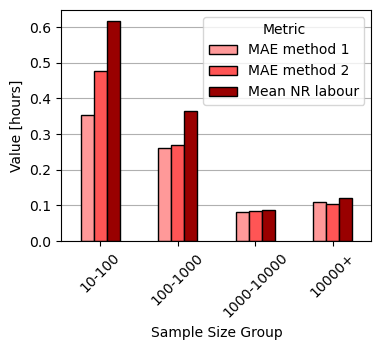

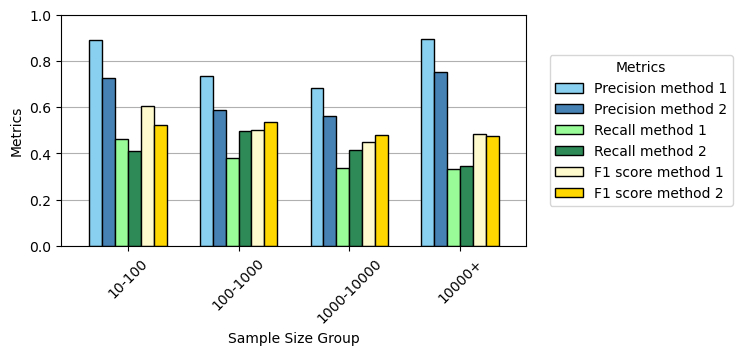

In [43]:
# Creating a plot with specified figure size
fig, ax = plt.subplots(figsize=(4, 3))
binned_grouped['MAE full'] = binned_grouped_full['MAD']
binned_grouped['Precision_full'] = binned_grouped_full['Precision']
binned_grouped['Recall_full'] = binned_grouped_full['Recall']
binned_grouped['F1_Score_full'] = binned_grouped_full['F1_Score']



binned_grouped[['MAE full', 'MAD', 'MZD']].plot(kind='bar', color=['#FF9999', '#FF5555', '#990000'],edgecolor='black', ax=ax, zorder=2)
#ax.set_title('Comparison of Mean Absolute Error and Mean Value by Sample Size Group')
ax.legend(['MAE method 1', 'MAE method 2', 'Mean NR labour'], title='Metric')
ax.set_xlabel('Sample Size Group')
ax.set_ylabel('Value [hours]')
ax.grid(True, axis='y')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Displaying the plot
plt.show()

# Defining closer shades for each pair: Precision (blue shades), Recall (green shades), F1 Score (yellow shades)
colors = ['#89CFF0', '#4682B4',  # Close shades of blue for Precision
          '#98FB98', '#2E8B57',  # Close shades of green for Recall
          '#FFFACD', '#FFD700']  # Close shades of yellow for F1 Score

fig, ax = plt.subplots(figsize=(6, 3))  # Specify the figsize here directly
binned_grouped[['Precision_full', 'Precision', 'Recall_full', 'Recall', 'F1_Score_full', 'F1_Score']].plot(kind='bar', width=0.7, color=colors, edgecolor='black', ax=ax, zorder=2)
#ax.set_title('Precision, Recall, and F1 Score by Sample Size Group')
ax.set_xlabel('Sample Size Group')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # Rotate labels to 45 degrees
ax.set_ylabel('Metrics')
ax.set_ylim([0, 1])
ax.grid(True, axis='y')
ax.legend(['Precision method 1', 'Precision method 2', 'Recall method 1', 'Recall method 2', 'F1 score method 1', 'F1 score method 2'], title='Metrics', bbox_to_anchor=(1.05, 0.5), loc='center left', borderaxespad=0.)
plt.show()

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:27: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:28: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:30: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



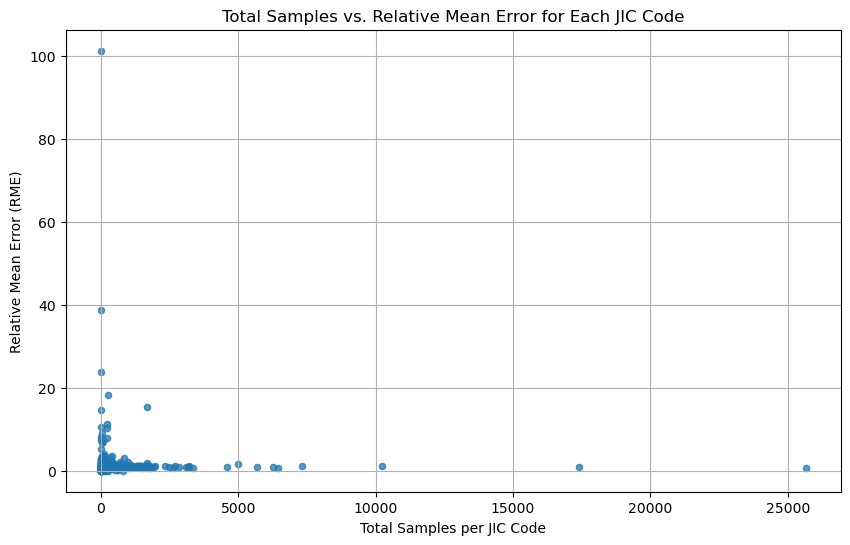

<Figure size 1200x800 with 0 Axes>

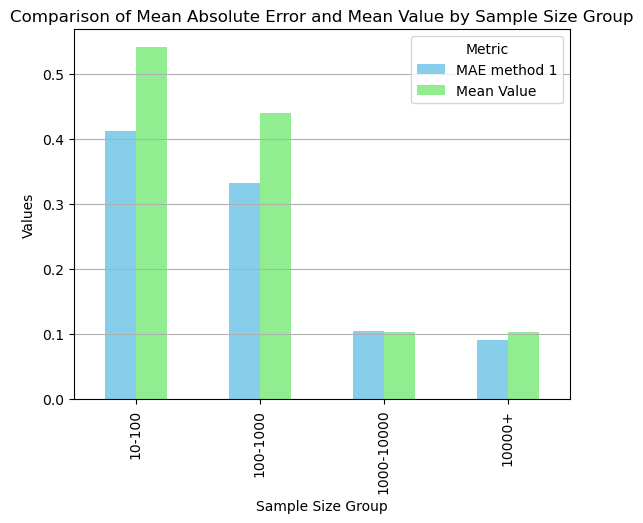

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:87: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:88: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/gm/pvnntq692jd5ng0rtk5l0z9m0000gn/T/ipykernel_51085/2324323594.py:90: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



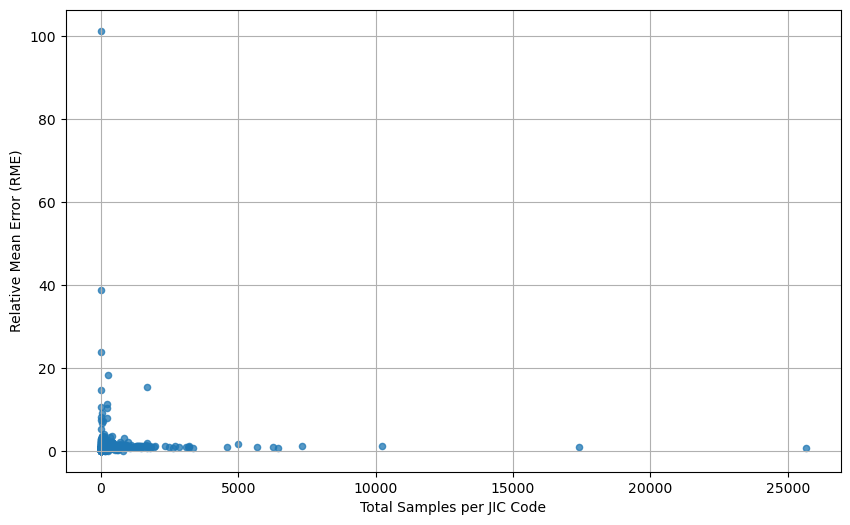

<Figure size 1200x800 with 0 Axes>

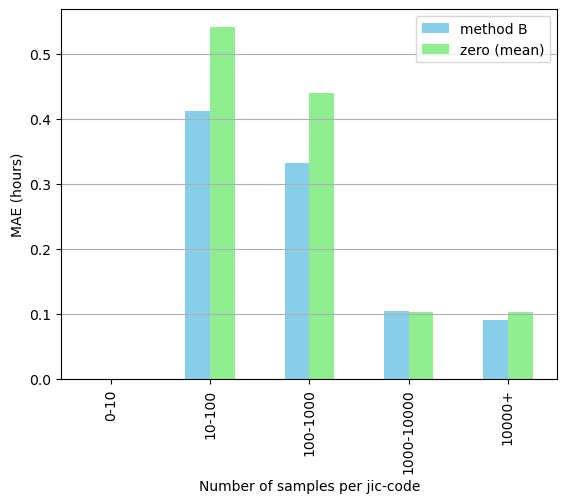

In [ ]:
X_test_h['total_samples'] = X_test_h['jic_code'].map(dict_jic_lengths)

# Calculate absolute deviations and actual values deviation
X_test_h['abs_deviation'] = abs(y_pred_h - y_test_h)
X_test_h['zero_deviation'] = abs(y_test_h)
X_test_h['prediction'] = y_pred_h
#X_test_h['full prediction'] = abs(y_pred_h_full - y_test_h_full)

# Group by 'jic_code' to calculate mean absolute deviation and mean actual deviation, using the 'total_samples' for sizing
grouped = X_test_h.groupby('jic_code').agg(
    MAD=('abs_deviation', 'mean'),
    #MFD=('full prediction', 'mean'),
    MZD=('zero_deviation', 'mean'),
    MP=('prediction', 'mean'),
    total_samples=('total_samples', 'first')  # 'first' because all entries per group are the same
)

# Calculate the Relative Mean Error (RME) as MAD divided by MZD
grouped['RME'] = grouped['MAD'] / grouped['MZD']

# Create bins for total samples
bins = [10, 100, 1000, 10000, np.inf]  # Adjust as needed
labels = ['10-100', '100-1000', '1000-10000', '10000+']
grouped['sample_bin'] = pd.cut(grouped['total_samples'], bins=bins, labels=labels, right=False)

# Calculate mean RME for each bin
bin_grouped = grouped.groupby('sample_bin')['MAD'].mean()
bin_grouped_zero = grouped.groupby('sample_bin')['MZD'].mean()
#bin_grouped_full = grouped.groupby('sample_bin')['MFD'].mean()
bin_grouped_pred = grouped.groupby('sample_bin')['MP'].mean()

# Scatter Plot for RME vs Total Samples
plt.figure(figsize=(10, 6))
plt.scatter(grouped['total_samples'], grouped['RME'], s=20, alpha=0.75)
plt.title('Total Samples vs. Relative Mean Error for Each JIC Code')
plt.xlabel('Total Samples per JIC Code')
plt.ylabel('Relative Mean Error (RME)')
#plt.xscale('log')
#plt.yscale('log')
plt.grid(True)
plt.show()

# Create a new DataFrame to hold the data for plotting
combined_data = pd.DataFrame({
    'MAE method 1': bin_grouped,
    #'MAE method 2': bin_grouped_full,
    'Mean Value': bin_grouped_zero,
})

# Bar Chart for Combined Metrics by Sample Size Group
plt.figure(figsize=(12, 8))
combined_data.plot(kind='bar', color=['skyblue', 'lightgreen', 'red'])
plt.title('Comparison of Mean Absolute Error and Mean Value by Sample Size Group')
plt.xlabel('Sample Size Group')
plt.ylabel('Values')
plt.grid(axis='y')
plt.legend(title='Metric')
plt.show()

# Add the total samples count for each jic_code to X_test_h
X_test_h['total_samples'] = X_test_h['jic_code'].map(dict_jic_lengths)

# Calculate absolute deviations and actual values deviation
X_test_h['abs_deviation'] = abs(y_pred_h - y_test_h)
X_test_h['zero_deviation'] = abs(y_test_h)
X_test_h['prediction'] = y_pred_h
X_test_h['full prediction'] = abs(y_pred_h_full - y_test_h_full)

# Group by 'jic_code' to calculate mean absolute deviation and mean actual deviation, using the 'total_samples' for sizing
grouped = X_test_h.groupby('jic_code').agg(
    MAD=('abs_deviation', 'mean'),
    MFD=('full prediction', 'mean'),
    MZD=('zero_deviation', 'mean'),
    MP=('prediction', 'mean'),
    total_samples=('total_samples', 'first')  # 'first' because all entries per group are the same
)

# Calculate the Relative Mean Error (RME) as MAD divided by MZD
grouped['RME'] = grouped['MAD'] / grouped['MZD']

# Create bins for total samples
bins = [0, 10, 100, 1000, 10000, np.inf]  # Adjust as needed
labels = ['0-10', '10-100', '100-1000', '1000-10000', '10000+']
grouped['sample_bin'] = pd.cut(grouped['total_samples'], bins=bins, labels=labels, right=False)

# Calculate mean RME for each bin
bin_grouped = grouped.groupby('sample_bin')['MAD'].mean()
bin_grouped_zero = grouped.groupby('sample_bin')['MZD'].mean()
#bin_grouped_full = grouped.groupby('sample_bin')['MFD'].mean()
bin_grouped_pred = grouped.groupby('sample_bin')['MP'].mean()

# Scatter Plot for RME vs Total Samples
plt.figure(figsize=(10, 6))
plt.scatter(grouped['total_samples'], grouped['RME'], s=20, alpha=0.75)
#plt.title('Total Samples vs. Relative Mean Error for Each JIC Code')
plt.xlabel('Total Samples per JIC Code')
plt.ylabel('Relative Mean Error (RME)')
#plt.xscale('log')
#plt.yscale('log')
plt.grid(True)
plt.show()

# Create a new DataFrame to hold the data for plotting
combined_data = pd.DataFrame({
    #'method A': bin_grouped_full,
    'method B': bin_grouped,
    'zero (mean)': bin_grouped_zero,
})

# Bar Chart for Combined Metrics by Sample Size Group
plt.figure(figsize=(12, 8))
combined_data.plot(kind='bar', color=['skyblue', 'lightgreen', 'red'])
#plt.title('Comparison of Mean Absolute Error and Mean Value by Sample Size Group')
plt.xlabel('Number of samples per jic-code')
plt.ylabel('MAE (hours)')
plt.grid(axis='y')
plt.legend()
plt.show()



